# Final Project

reference: https://github.com/stevetjoa/stanford-mir

In [340]:
import mir
import librosa, librosa.display
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
from copy import deepcopy

# Import File

In [341]:
ori, ori_sr = librosa.load('1.mp3', sr=44100, duration=60)
ipd.Audio(data=ori, rate=ori_sr)

In [342]:
sr = 44100
x = librosa.effects.pitch_shift(ori, ori_sr, -1)
x = librosa.core.resample(x, ori_sr, 16002)
x = librosa.core.resample(x, 16002, sr)
ipd.Audio(data=x, rate=sr)

/Users/puwei/anaconda3/lib/python3.6/site-packages/librosa/effects.py:290: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if bins_per_octave < 1 or not np.issubdtype(type(bins_per_octave), np.int):
/Users/puwei/anaconda3/lib/python3.6/site-packages/librosa/util/utils.py:1725: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(x.dtype, float) or np.issubdtype(x.dtype, complex):


In [343]:
x = librosa.effects.time_stretch(x,1.2)
beg = 0
dur = 120
x = x[int(beg*sr):int((beg+dur)*sr)]
ipd.Audio(data=x, rate=sr)

/Users/puwei/anaconda3/lib/python3.6/site-packages/librosa/util/utils.py:1725: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(x.dtype, float) or np.issubdtype(x.dtype, complex):


# Detect Onsets

In [344]:
onset_frames = librosa.onset.onset_detect(x, sr=sr, hop_length=512)
print(onset_frames)

[  42   88  137  161  185  210  231  257  280  305  319  328  352  376
  399  426  437  448  462  472  497  511  519  544  568  592  606  615
  640  662  689  701  711  734  758  782  795  806  832  844  855  902
  927  950  976  998 1022 1045 1071 1083 1093 1117 1141 1164 1189 1213
 1237 1263 1276 1285 1309 1333 1358 1370 1380 1405 1418 1430 1477 1500
 1525 1549 1572 1598 1620 1649 1668 1693 1716 1741 1763 1788 1812 1837
 1859 1884 1908 1931 1955 1980 2004 2017 2050 2075 2098 2123 2137 2145
 2171 2194 2219 2241 2266 2290 2314 2338 2359 2387 2424 2433 2458 2481
 2494 2507 2528 2554 2567 2576 2602 2625 2649 2673 2697 2721 2745 2769
 2794 2816 2840 2864 2888 2911 2936 2960 2985 3008 3032 3056 3079 3104
 3127 3137 3151 3176 3199 3223 3247 3260 3272 3293 3319 3342 3367 3390
 3415 3438 3463 3485 3512 3534 3560 3571 3582 3606 3629 3654 3677 3702
 3725 3772 3797 3821 3845 3868 3892 3917 3965 3989 4012 4037 4060 4085
 4109 4133 4136 4157 4180 4205 4228 4251 4277 4301]


In [345]:
onset_times = librosa.frames_to_time(onset_frames)
print(onset_times)

[ 0.9752381   2.04335601  3.18113379  3.7384127   4.29569161  4.87619048
  5.36380952  5.96752834  6.5015873   7.08208617  7.40716553  7.61614512
  8.17342404  8.73070295  9.2647619   9.89170068 10.14712018 10.40253968
 10.72761905 10.95981859 11.54031746 11.86539683 12.05115646 12.63165533
 13.18893424 13.74621315 14.07129252 14.28027211 14.86077098 15.37160998
 15.99854875 16.27718821 16.50938776 17.04344671 17.60072562 18.15800454
 18.45986395 18.71528345 19.31900227 19.59764172 19.85306122 20.94439909
 21.52489796 22.05895692 22.66267574 23.17351474 23.73079365 24.26485261
 24.86857143 25.14721088 25.37941043 25.93668934 26.49396825 27.02802721
 27.60852608 28.16580499 28.7230839  29.32680272 29.62866213 29.83764172
 30.39492063 30.95219955 31.53269841 31.81133787 32.04353741 32.62403628
 32.92589569 33.20453515 34.29587302 34.82993197 35.41043084 35.96770975
 36.50176871 37.10548753 37.61632653 38.28970522 38.73088435 39.31138322
 39.84544218 40.42594104 40.93678005 41.51727891 42

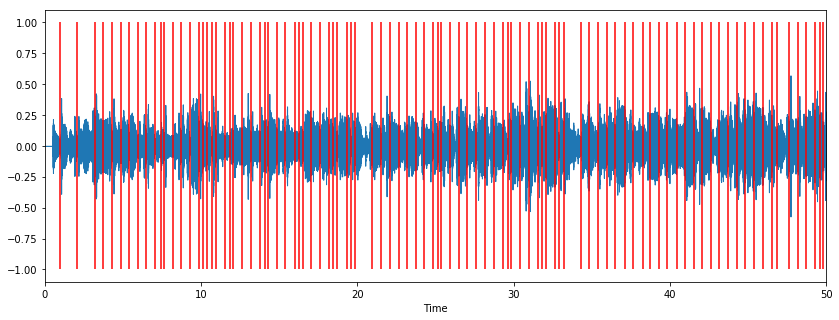

In [346]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)
plt.vlines(onset_times,-1,1,color='r')
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

# Detect Beats

/Users/puwei/anaconda3/lib/python3.6/site-packages/librosa/util/utils.py:1725: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(x.dtype, float) or np.issubdtype(x.dtype, complex):


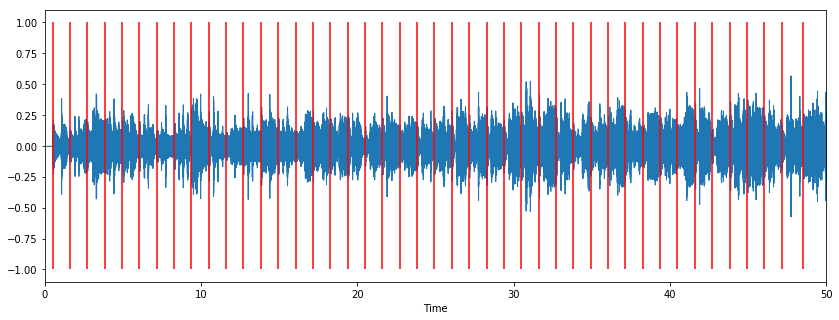

In [347]:
tempo, beat_times = librosa.beat.beat_track(x, sr=sr, start_bpm=60, units='time')
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)
plt.vlines(beat_times, -1, 1, color='r')
clicks = librosa.clicks(beat_times, sr=sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

# Get a Base Pitch for Every Beat

In [348]:
def detect_pitch(window, sr, fmin=50, fmax=2000):
    r = librosa.autocorrelate(window)
    r[:int(sr/fmax)] = 0
    r[int(sr/fmin):] = 0
    if r.shape[0] == 0:
        return 0
    return sr/r.argmax()

result = []

for i in range(len(onset_times)-1):
    start = onset_times[i]
    end = onset_times[i+1]
    pitch = detect_pitch(x[int(start*sr):int(end*sr)],sr)
    result.append([start,end,detect_pitch(x[int(start*sr):int(end*sr)],sr)])

print(len(result));

191


In [349]:
beat_pitch = [[0,0] for i in range(len(beat_times))]

for i in result:
    idx = abs(i[0]-beat_times).argmin() 
    beat_pitch[idx][1] += 1
    beat_pitch[idx][0] = (beat_pitch[idx][0]+i[2])/beat_pitch[idx][1]

beat_pitch = [int(i[0]) for i in beat_pitch]
    
print(beat_pitch)

[2004, 2004, 2004, 2004, 2004, 2004, 1336, 2004, 2004, 835, 1014, 2004, 1013, 2004, 1336, 2004, 1336, 1336, 2004, 2004, 2004, 2004, 1336, 2004, 2004, 2004, 1336, 454, 421, 1013, 801, 616, 2004, 2004, 2004, 2004, 2004, 2004, 746, 2004, 2004, 2004, 2004, 0]


In [350]:
def sin_tone(f,t):
    return [numpy.sin(2*numpy.pi*f*n) for n in numpy.arange(0,t,1/sr)]

ipd.Audio(data=numpy.concatenate([sin_tone(i,0.5) for i in beat_pitch]), rate=sr)

# Generate Sound Effects

ValueError: operands could not be broadcast together with shapes (2204672,) (5292000,) 

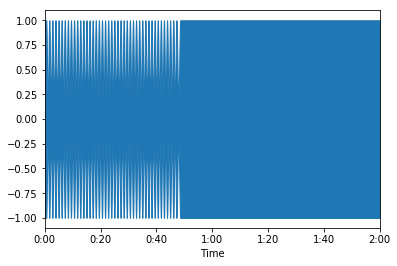

In [351]:
multiplier = numpy.ones(sr*dur)

for i in range(0,len(beat_times)-1):
    start = beat_times[i]
    duration = beat_times[i+1]-beat_times[i]
    multiplier[int(start*sr):int(start*sr)+int(duration*sr)] = [0.4*numpy.cos(2*numpy.pi*n/(duration*sr))+0.6 for n in range(int(duration*sr))]

librosa.display.waveplot(multiplier, sr=sr)
ipd.Audio(data=x*multiplier, rate=sr)
    

In [ ]:
drum, drum_sr = librosa.load('instruments/kick.wav',sr=44100)
snare, snare_sr = librosa.load('instruments/snare.wav',sr=44100)
ipd.Audio(data=snare, rate=snare_sr)
# ipd.Audio(data=drum, rate=drum_sr)

In [ ]:
offset = 0
x1 = deepcopy(x)

for i in range(offset,len(beat_times)-1):
    start = beat_times[i]
    end = beat_times[i+1]
    middle = 0.5*(start+end)-0.05
    x1[int(middle*sr):int(middle*sr)+drum.shape[0]] += 2*drum
    
ipd.Audio(data=x1*multiplier, rate=sr)

In [ ]:
offset = 0
x2 = deepcopy(x1)

for i in range(offset,len(beat_times)-1):
    start = beat_times[i]
    end = beat_times[i+1]-0.02
    x2[int(end*sr):int(end*sr)+snare.shape[0]] += 0.4*snare
ipd.Audio(data=x2*multiplier, rate=sr)

In [ ]:
offset = 4
x3 = deepcopy(x2)

for i in range(offset,len(beat_times)-2,2):
    start = beat_times[i]
    end = beat_times[i+1]
    middle = 0.5*(start+end)+0.25
    x3[int(middle*sr):int(middle*sr)+drum.shape[0]] += 0.6*drum

offset = 8
for i in range(offset,len(beat_times)-4,4):
    start = beat_times[i]
    end = beat_times[i+1]
    middle = 0.5*(start+end)-0.15
    x3[int(middle*sr):int(middle*sr)+drum.shape[0]] += 0.6*drum
    x3[int(middle*sr):int(middle*sr)+drum.shape[0]] += 0.6*drum


ipd.Audio(data=x3*multiplier, rate=sr)

In [ ]:
offset = 0
x4 = deepcopy(x3)

def fm(base):
    Fm = 440
    return [min(1,0.5*numpy.log(n+1))*numpy.exp(-n)*numpy.cos(2*numpy.pi*220*n+(numpy.exp(n))*numpy.cos(2*numpy.pi*Fm*n))*numpy.sin(2*numpy.pi*443*n) for n in numpy.arange(0,5,1/sr)]

for i in range(offset,len(beat_times)-8,100):
    start = beat_times[i]
    end = beat_times[i+1]
    middle = 0.5*(start+end)
    syn = numpy.array(fm(beat_pitch[i]))
    x4[int(middle*sr):int(middle*sr)+len(syn)] += 0.6*syn

offset = 6
    
for i in range(offset,len(beat_times)-8,100):
    start = beat_times[i]
    end = beat_times[i+1]
    middle = 0.5*(start+end)
    syn = numpy.array(fm(beat_pitch[i]))
    x4[int(middle*sr):int(middle*sr)+len(syn)] += 0.6*syn[::-1]


ipd.Audio(data=x4, rate=sr)